# Practical 7: Interactive maps

In this final practial of the workshop we will create interactive maps. We will revisit some of the choropleth mapping techniques and we will explore some other mapping techniques, too. Interactive maps can be a great option for displaying and sharing data online. Viewers have the option to interact with your visualisation, making it more engaging.

We will continue to work with our example data from Southampton, although we will look at a few different datasets from before.

Learning objectives:
* create an interactive map with basemap and multiple layers
* save the output as a `.html` file
* display attribute information in pop-up windows
* create density map and know when to apply this technique


## Preparations for mapping

To make our interactive maps, we will be using `folium`. This package links with the `leaflet.js` library ([https://leafletjs.com/](https://leafletjs.com/)).

The documentation for `folium` can be found here: [https://python-visualization.github.io/folium/](https://python-visualization.github.io/folium/). We'll point a few key features as we go along, but be sure to pay attention to your CRS (again!). `folium` maps need inputs in latitude/longitude, so we'll be reprojecting from EPSG:27700. We will also need to convert our `GeoDataFrames` into GeoJSON formats.

In [1]:
# load the packages
import geopandas as gpd
import folium
import matplotlib.pyplot as plt

### Making a simple basemap

An overview map with a set of tiles for a basemap can be created with just a couple lines of code. 

We will supply the `.Map` with a `location` to tell it where to center the map initially, as well as an initial zoom level. Zoom levels are values from typically 0 to 18. Small numbers are "zoomed out" while higher numbers are "zoomed in".

In [2]:
# simple basemap
# create an instance of a `Map`
m = folium.Map(location=[50.934358, -1.399073],  # latitude, longitude
               zoom_start=15
              )

# show the map
m

Try panning and zooming the map. Leaflet maps are very common on the internet now, so this should seem familiar to you.

### Changing the basemap tiles

By default our basempa is using OpenStreetMap tiles. There are few other sets of tiles available from Leaflet. Other tiles can be accessed if you have accounts with providers.

To change the basemap, set `tiles` parameter.

In [3]:
# changing the basemap
m = folium.Map(location=[50.934358, -1.399073], 
               tiles='Stamen watercolor',  # artisitc basemap style
               zoom_start=15
              )

# show the map
m

We can also add another basemap to our `Map`. This step will not create a new map object, but add a layer as an option. We will also add a new control object to the map so that a user can toggle on/off the basemap of their choice.

Notice the layer control button in the upper-right of the map below

In [4]:
# add basemap option
folium.TileLayer('stamentoner').add_to(m)

# add a control to select layers
folium.LayerControl().add_to(m)

m

### Load the data

This is great to be able to quickly create an interactive basemap, but we need to add in our own data. See this step as part of a large workflow - you can do various data cleaning and spatial analysis steps using `GeoPandas` and the other Python tools and then create sophisticated visualisations 

Let's load up the food point locations for Southampton.

In [5]:
# load supermarkets
smkt = gpd.read_file('../data/soton_smkts.gpkg')
# convert from multipoint to single point
smkt = smkt.explode()
# project to WGS84
smkt = smkt.to_crs(4326)

smkt.head()

,,id,@id,addr:city,addr:country,addr:housenumber,addr:postcode,addr:state,addr:street,brand,brand:wikidata,...,start_date,building:part,indoor,old_name,smoking,source:fhrs_ref,fhrs:local_authority_id,name:en,last_checked,geometry
0,0,node/300149741,node/300149741,Southampton,GB,117,SO14 2EA,None,High Street,None,None,...,None,None,None,None,None,None,None,None,None,POINT (-1.40416 50.89806)
1,0,node/638921542,node/638921542,Southampton,GB,"412,414",SO18 5RS,None,Bitterne Road,None,None,...,None,None,None,None,None,None,None,None,None,POINT (-1.36080 50.91421)
2,0,node/1556159256,node/1556159256,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,POINT (-1.39694 50.90609)
3,0,node/2029179283,node/2029179283,Southampton,GB,17,SO18 1NN,None,Manor Farm Road,None,None,...,None,None,None,None,None,None,None,None,None,POINT (-1.37570 50.92465)
4,0,node/5007213122,node/5007213122,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,International Foods,None,POINT (-1.39410 50.91094)


In [6]:
# load fast food restaurants
ff = gpd.read_file('../data/soton_fastfood.gpkg')
# convert from multipoin to single point
ff = ff.explode()
# reproject to WGS84
ff = ff.to_crs(4326)

ff.head()

,,id,@id,addr:city,addr:country,addr:housename,addr:postcode,addr:street,addr:unit,amenity,brand,...,official_name,fixme:addr2,fixme:addr4,indoor,payment:cryptocurrencies,payment:electronic_purses,source:operator,payment:cheque,path,geometry
0,0,way/171779227,way/171779227,None,None,None,None,Bedford Place,None,fast_food,Panda Express,...,None,None,None,None,None,None,None,None,"Point?crs=EPSG:4326&field=fid:long(0,0)&field=...",POINT (-1.40596 50.91206)
1,0,way/153481049,way/153481049,None,None,None,None,Hanover Buildings,None,fast_food,Taco Bell,...,None,None,None,None,None,None,None,None,"Point?crs=EPSG:4326&field=fid:long(0,0)&field=...",POINT (-1.40353 50.90324)
2,0,way/190393762,way/190393762,None,None,None,None,None,None,fast_food,None,...,None,None,None,None,None,None,None,None,"Point?crs=EPSG:4326&field=fid:long(0,0)&field=...",POINT (-1.39649 50.90568)
3,0,way/190393777,way/190393777,None,None,None,None,None,None,fast_food,None,...,None,None,None,None,None,None,None,None,"Point?crs=EPSG:4326&field=fid:long(0,0)&field=...",POINT (-1.39649 50.90501)
4,0,way/190393781,way/190393781,None,None,None,None,None,None,fast_food,None,...,None,None,None,None,None,None,None,None,"Point?crs=EPSG:4326&field=fid:long(0,0)&field=...",POINT (-1.39650 50.90497)


## Simple marker map

In order add these points to our map, we have to convert our DataFrames into GeoJSON format and then create a new layer of `Markers`. 

In [7]:
# conversion
ff_gj = folium.features.GeoJson(ff, 
                                name='Fast Food'  # give the layer a name
                               )

In [8]:
# create a fresh map
m = folium.Map(location=[50.934358, -1.399073],
               zoom_start=12,
               control_scale=True  # add a scale bar to the map
              )

# add the points
ff_gj.add_to(m)

# include control for turning on/off points
folium.LayerControl().add_to(m)

# show the map
m

### Multiple layers

We will now add another set of markers for our supermarkets, but we're going to do it differently to show how to create `Markers`. This will not convert the GeoDataFrame to GeoJSON, but it will access the coordinates in a loop across the features. This process will also let us easily set a custom icon colour for the supermarket layer.

In [9]:
# create basemap
m = folium.Map(location=[50.934358, -1.399073],
               zoom_start=12,
               control_scale=True  # add a scale bar to the map
              )

# add the fast food points (default blue colour)
ff_gj.add_to(m)

# add the supermarket points the map
for idx, feature in smkt.iterrows():
    marker = folium.map.Marker([feature['geometry'].y, feature['geometry'].x], 
                               icon=folium.Icon(color='green')
                              ).add_to(m)

# show the results
m

### Clustering markers

Interactive maps can sometimes look a bit too cluttered with markers, especially when zoomed out further. One solution for this is to cluster the markers into groups that are visible when a user moves in closer. We'll revise our map to cluster the fast food points and add this as a new layer.

We will make use of one `folium`'s useful plugins: [`MarkerCluster`](https://github.com/python-visualization/folium/blob/master/examples/MarkerCluster.ipynb).

In [10]:
from folium.plugins import MarkerCluster

In [11]:
# start with a base map
m = folium.Map(location=[50.934358, -1.399073],
               zoom_start=12,
               control_scale=True
              )

In [12]:
# create a set of locations from the fast food points
# lists of coordinate pairs in lat, long
locns = list(zip(ff.geometry.y, ff.geometry.x))

In [13]:
# create the marker clusters
mc = MarkerCluster(locns)

# add to the map
mc.add_to(m)

# show the map
m

Try hovering over each cluster and then clicking. Or zooming in or out on the data.

If you have time, try creating a `MarkerCluster` layer for the supermarket locations, too.

## Heat maps

Sometimes our objective with a map is not to show individual features (like a set of points), but to highlight the broader spatial pattern. In the case of fast food restaurants, we may want a map to highlight areas with a greater density of sites. We can use a different type of map, one which is often called a *heat map*. 

Heat maps use a 2D kernel to express the density of point locations as a surface. Another plugin within `folium` provides easy access to this functionality.

#### Side note:

To create kernel density (i.e. heat maps) in a static map, we can use `seaborn`'s `kdeplot` ([https://seaborn.pydata.org/generated/seaborn.kdeplot.html](https://seaborn.pydata.org/generated/seaborn.kdeplot.html)).

In [14]:
# load plugin
from folium.plugins import HeatMap

In [15]:
# create a new, clean basemap
m = folium.Map(location=[50.934358, -1.399073],
               zoom_start=12,
               control_scale=True
              )

In [16]:
# calculate a heat map
# use locations (see above)
hm = HeatMap(locns, 
             name='FF_heatmap'
            )

# add to map
hm.add_to(m)

# add control
folium.LayerControl().add_to(m)

m

There are a lot of restaurants in the city centre and Shirley High Street!

Interactive heat maps are scale (or zoom) dependent. Notice how the density changes as you zoom in and out. Try creating another heat map with fast food locations and alter the `radius` (default 25) and `blur` (default 15) options.

In [ ]:
# create a new heat map layer
# adjust radius=, and blur=


#

## Choropleth maps

We will return now to the common choropleth map that we introduced in the previous practicals on static maps. Since we're now building interactive maps, we can add a few new features to these, including pop-ups and actions when a user hovers over the data.

To make things a bit more interesting, we will also introduce a new dataset and review some previous processing steps on merging data.

The data we are using are the Index of Multiple Deprivation (IMD) which ranks each LSOA based on multiple criteria. We'll map the decile ranks. Values of 1 are among the most deprived areas. Values of 10 are among the least deprived 10% of areas in all of England. Find out more about these data here: [https://www.gov.uk/government/statistics/english-indices-of-deprivation-2019](https://www.gov.uk/government/statistics/english-indices-of-deprivation-2019).

In [17]:
import pandas as pd

# load the LSOA boundary data
lsoa = gpd.read_file('../data/soton_lsoa_distance.gpkg')

# load IMD table
imd = pd.read_csv('../data/IMD2019_Index_of_Multiple_Deprivation.csv')
# rename columns for convenience
imd = imd.rename(columns={'LSOA code (2011)':'lsoa',
                          'Index of Multiple Deprivation (IMD) Decile':'imd_decile'
                         })
imd = imd[['lsoa','imd_decile']]

In [18]:
imd.head()

,lsoa,imd_decile
0,E01000001,9
1,E01000002,10
2,E01000003,5
3,E01000005,3
4,E01000006,5


In [19]:
# create an inner join to keep only Southampton records
lsoa = lsoa.merge(imd, on='lsoa')

In [20]:
lsoa.head()

,lsoa,smkt_count,smkt_dist,geometry,imd_decile
0,E01017136,0.0,257.280417,"POLYGON ((441876.774 112587.161, 441877.875 11...",5
1,E01017137,1.0,269.526033,"POLYGON ((441632.370 112875.041, 441631.994 11...",5
2,E01017138,0.0,372.747407,"POLYGON ((441307.700 112577.580, 441308.208 11...",6
3,E01017139,1.0,247.854310,"POLYGON ((442373.000 111482.000, 442372.963 11...",2
4,E01017140,4.0,331.716277,"POLYGON ((441981.000 111652.000, 441980.000 11...",3


In [21]:
# project the data into WGS84
lsoa = lsoa.to_crs(4326)

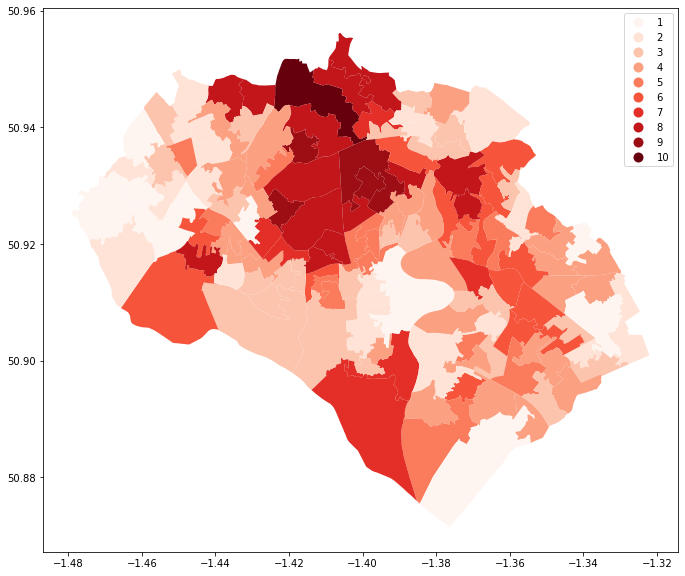

In [22]:
# make a simple static map of the index of multiple deprivation
lsoa.plot('imd_decile',
          categorical=True,
          legend=True,
          cmap='Reds',
          figsize=(15,10)
         )

plt.show()

Now if we want to create a similar map, but interactive using the tools from `folium`, we need to do a bit a preparation first. We already have a unique id column `lsoa`. If we did not, we would need to create it and make it the first column in the attribute table. 

#### Interactive format

Interactive choropleth maps use the `folium.Choropleth` method, demonstrated here: [https://python-visualization.github.io/folium/quickstart.html#Choropleth-maps](https://python-visualization.github.io/folium/quickstart.html#Choropleth-maps) and here: [https://python-visualization.github.io/folium/modules.html#folium.features.Choropleth](https://python-visualization.github.io/folium/modules.html#folium.features.Choropleth).

In [23]:
# create a `folium` basemap
m = folium.Map(location=[50.934358, -1.399073],  # latitude, longitude
               tiles='cartodbpositron',
               zoom_start=12,
               control_scale=True # add scale bar
              )

# add a choropleth layer
folium.Choropleth(
    geo_data=lsoa, # GeoDataFrame
    name='IMD_2019', # name on the layer control
    data=lsoa, # same GeoDataFrame, potentally a different data source
    columns=['lsoa', 'imd_decile'], # select the columns desired
    key_on='feature.properties.lsoa', # <-- tricky part: need a unique ID, in the GeoJSON 
    fill_color='Reds',
    fill_opacity=0.7,  # transparency 0-1
    line_opacity=0.7,
    legend_name='Index of Multiple Deprivation (IMD 2019)' # name on the legend
).add_to(m) # add to the map

# add control to turn layer on/off
folium.LayerControl().add_to(m)

m


A nice feature to add legibility for users, it to highlight their cursor position. This feature can be turned on, by enabling the option `highlight=`.

In [24]:
# create a `folium` basemap
m = folium.Map(location=[50.934358, -1.399073],  # latitude, longitude
               tiles='cartodbpositron',
               zoom_start=12,
               control_scale=True # add scale bar
              )

# add a choropleth layer
folium.Choropleth(
    geo_data=lsoa, # GeoDataFrame
    name='IMD_2019', # name on the layer control
    data=lsoa, # same GeoDataFrame, potentally a different data source
    columns=['lsoa', 'imd_decile'], # select the columns desired
    key_on='feature.properties.lsoa', # <-- tricky part: need a unique ID, in the GeoJSON 
    fill_color='Reds',
    fill_opacity=0.7,  # transparency 0-1
    line_opacity=0.7,
    legend_name='Index of Multiple Deprivation (IMD 2019)', # name on the legend
    highlight=True # THIS IS NEW
).add_to(m) # add to the map

# add control to turn layer on/off
folium.LayerControl().add_to(m)

m

### Colormaps and symbology

`folium` choropleths automatically accept certain ColorBrewer palettes for symbologies. To have more control over the color scale, you must create a separate styling function and apply this function to features of a GeoJSON dataset (converting from GeoDataFrame using `folium.features.GeoJson`. 

We will demonstrate an implementation to take the IMD decile values and apply one of the qualitative colour sets.

In [25]:
# create a `folium` basemap
m = folium.Map(location=[50.934358, -1.399073],  # latitude, longitude
               tiles='cartodbpositron',
               zoom_start=12,
               control_scale=True # add scale bar
              )

# just a demonstration set of colours - not recommended
colors = ['#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99',
          '#e31a1c','#fdbf6f','#ff7f00','#cab2d6','#6a3d9a']

# define a function
def style_function(feature):
    return {
        'fillOpacity': 0.7,
        'weight': 0,
        'color':'black',
        'fillColor': colors[int(feature['properties']['imd_decile'])-1]
    }


# add a choropleth layer as GeoJson
folium.features.GeoJson( # note: not using Choropleth
    lsoa, 
    style_function=style_function,
    name='IMD_2019'
).add_to(m) # add to the map

# add control to turn layer on/off
folium.LayerControl().add_to(m)

m

### Tooltips and pop-ups

Our final addition to our interactive choropleth map will be to add querying capabilities. `folium.Choropleth` doesn't allow for us to add labels directly, so we'll do a workaround by creating a GeoJSON tooltip. Tooltips show text when a user hovers over the object.

**Side Note** when you're using `Markers` (as we did above with the supermarkets), you can add both tooltips and popups. Pop-ups allow for more formatting and can be a nice way for users. If you have time, try creating a new map of supermarkets in Southampton with pop-ups to display their name or address.

In [26]:
# create a `folium` basemap
m = folium.Map(location=[50.934358, -1.399073],  # latitude, longitude
               tiles='cartodbpositron',
               zoom_start=12,
               control_scale=True # add scale bar
              )

# add a choropleth layer
# out put an object (THIS IS NEW)
choropleth = folium.Choropleth(
    geo_data=lsoa, # GeoDataFrame
    name='IMD_2019', # name on the layer control
    data=lsoa, # same GeoDataFrame, potentally a different data source
    columns=['lsoa', 'imd_decile'], # select the columns desired
    key_on='feature.properties.lsoa', # <-- tricky part: need a unique ID, in the GeoJSON 
    fill_color='Reds',
    fill_opacity=0.7,  # transparency 0-1
    line_opacity=0.7,
    legend_name='Index of Multiple Deprivation (IMD 2019)', # name on the legend
    highlight=True # THIS IS NEW
).add_to(m) # add to the map

# add control to turn layer on/off
folium.LayerControl().add_to(m)

# THIS IS NEW
# access the GeoJson created by `Choropleth`
# add a GeoJson ToolTip and add that layer to the map
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(fields=['lsoa','imd_decile'],
                                   aliases=['LSOA','IMD Decile'],
                                   style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;"),
                                   labels=True,
                                   sticky=True
                                  )
)

m

## Saving the outputs

When you've created a map that you are statisfied with, you can easily save it to `.html` and upload or share it with others. Try saving your map, and then take a look at the .html file to see how the data are stored. Remember you may need to change you paths.

In [ ]:
# output
m.save("../test_folium_map.html")

Finished! 